# **Face autoencoder**

In [2]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import Image, display

## **Visualization code**

Function that shows the result of a video as a GIF file.

In [2]:
def show_video(vid, vid2=None):
    if vid2 is None:
        plt.rcParams["figure.figsize"] = (1,1)
    else:
        plt.rcParams["figure.figsize"] = (2,1)
    fig = plt.figure()
    plt.axis('off')
    plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    plt.margins(0,0)
    ims = []
    for i in range(len(vid)):
        if vid2 is None:
            ims.append([plt.imshow(vid[i][:,:,::-1])])
        else:
            ims.append([plt.imshow(np.concatenate([vid[i][:,:,::-1], vid2[i][:,:,::-1]], axis=1))])
    ani = animation.ArtistAnimation(fig, ims, interval=30)
    ani.save('animation.gif', writer='pillow', fps=30)
    plt.close()

    display(Image(open('animation.gif','rb').read()))

## **Load processed video**

Obtain processed faces from numpy file.

(287, 128, 128, 3) float32


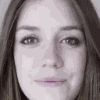

In [4]:
x_train = (np.load('video.npy')/255.0).astype(np.float32)
print(x_train.shape, x_train.dtype)
show_video(x_train)

## **Define network architecture**

Decoder is inverse of encoder.

In [28]:
def _encoder(x):
    x = tf.keras.layers.Conv2D(4, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.MaxPooling2D((2, 2), padding='same')(x)
    x = tf.keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.MaxPooling2D((2, 2), padding='same')(x)
    x = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.MaxPooling2D((2, 2), padding='same')(x)
    x = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.MaxPooling2D((2, 2), padding='same')(x)
    return x

def _decoder(x):
    x = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.UpSampling2D((2, 2))(x)
    x = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.UpSampling2D((2, 2))(x)
    x = tf.keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.UpSampling2D((2, 2))(x)
    x = tf.keras.layers.Conv2D(4, (3, 3), activation='relu', padding='same')(x)
    x = tf.keras.layers.UpSampling2D((2, 2))(x)
    x = tf.keras.layers.Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)
    return x

input = tf.keras.Input(shape=(128,128,3))
emb = _encoder(input)
x = _decoder(emb)
model = tf.keras.models.Model(inputs=input, outputs=x)
model.summary()

Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv2d_63 (Conv2D)          (None, 128, 128, 4)       112       
                                                                 
 max_pooling2d_28 (MaxPoolin  (None, 64, 64, 4)        0         
 g2D)                                                            
                                                                 
 conv2d_64 (Conv2D)          (None, 64, 64, 8)         296       
                                                                 
 max_pooling2d_29 (MaxPoolin  (None, 32, 32, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_65 (Conv2D)          (None, 32, 32, 16)        1168

## **Training and results**

Epoch 1:


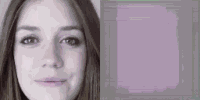

Epoch 2:


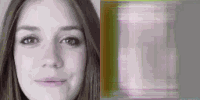

Epoch 4:


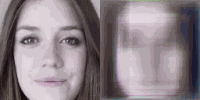

Epoch 8:


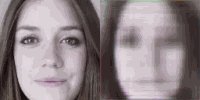

Epoch 16:


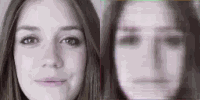

Epoch 32:


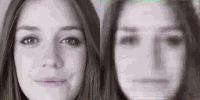

Epoch 64:


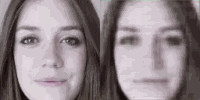

Epoch 128:


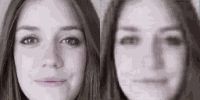

Epoch 256:


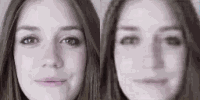

In [29]:
def plot_results():
    batch_size = 16

    output = []
    for x in range(0, len(x_train), batch_size):
        x_batch = x_train[x:x+batch_size]
        pred = model.predict(x_batch, verbose=0)
        output.append(pred)
    output = np.concatenate(output, axis=0)

    show_video(x_train, output)

class PlotCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        keys = list(logs.keys())
        if bin(epoch+1).count("1") == 1:
            print("Epoch {}:".format(epoch+1))
            plot_results()

plot_reconstruction = PlotCallback()

# training configuration
optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='mean_squared_error')

#train
model.fit(x=x_train,y=x_train, epochs=256, batch_size=16, verbose=0, callbacks=[plot_reconstruction])